# LQR Controller for an Inverted Pendulum on a Cart
## Rohan Panicker

In [71]:

import numpy as np
import scipy.linalg
from scipy.signal import cont2discrete
import matplotlib.pyplot as plt

from typing import Tuple

import cvxpy as cp



# Plotting style
plt.style.use('seaborn-v0_8-whitegrid')

## Short Derivation of Linearized Inverted Pendulum A & B Matrices

**System & State:**
* Cart mass $m_c$, pole mass $m_p$.
* Pole length to COM: $L$. Pole inertia about COM: $I_p$.
* Input force on cart: $u$. Gravity: $g$.
* State: $s = [x, \dot{x}, \theta, \dot{\theta}]^T$, where $x$ is cart position, $\theta$ is pole angle from vertical (upright is $\theta=0$).

* Note: point mass pole not considered!


**Linearized Equations of Motion (around $\theta=0, \dot{\theta}=0$):**
The coupled EOMs for accelerations $\ddot{x}$ and $\ddot{\theta}$ can be written as:
$$
\begin{bmatrix} m_c + m_p & m_p L \\ m_p L & I_p + m_p L^2 \end{bmatrix}
\begin{bmatrix} \ddot{x} \\ \ddot{\theta} \end{bmatrix}
=
\begin{bmatrix} u \\ m_p g L \theta \end{bmatrix}
$$

Let $M_{sys} = \begin{bmatrix} m_c + m_p & m_p L \\ m_p L & I_p + m_p L^2 \end{bmatrix}$.
The determinant is $D = (m_c + m_p)(I_p + m_p L^2) - (m_p L)^2 = I_p(m_c+m_p) + m_c m_p L^2$.

**Solving for Accelerations:**
$$
\begin{bmatrix} \ddot{x} \\ \ddot{\theta} \end{bmatrix}
=
M_{sys}^{-1}
\begin{bmatrix} u \\ m_p g L \theta \end{bmatrix}
=
\frac{1}{D}
\begin{bmatrix} I_p + m_p L^2 & -m_p L \\ -m_p L & m_c + m_p \end{bmatrix}
\begin{bmatrix} u \\ m_p g L \theta \end{bmatrix}
$$
This yields:
* $\ddot{x} = \frac{1}{D} [(I_p + m_p L^2)u - (m_p^2 L^2 g)\theta]$
* $\ddot{\theta} = \frac{1}{D} [-(m_p L)u + (m_c + m_p)m_p g L \theta]$

# Fast forward we get the following A and B matrices

**State-Space Matrices ($\dot{x} = Ax + Bu$):**
Given $\dot{s} = [\dot{x}, \ddot{x}, \dot{\theta}, \ddot{\theta}]^T$:

$A = \begin{bmatrix}
0 & 1 & 0 & 0 \\
0 & 0 & \frac{m_p^2 L^2 g}{D} & 0 \\
0 & 0 & 0 & 1 \\
0 & 0 & \frac{(m_c+m_p)m_p g L}{D} & 0
\end{bmatrix}$

$B = \begin{bmatrix}
0 \\
\frac{I_p + m_p L^2}{D} \\
0 \\
\frac{m_p L}{D}
\end{bmatrix}$


### 📚 References

- [Underactuated Robotics (MIT)](http://underactuated.mit.edu/acrobot.html#cart_pole)  
- K. Ogata, *Modern Control Engineering*, 4th ed., Prentice Hall, 2001.

In [72]:


class LinearizedInvertedPendulum():
    def __init__(self, mass_of_cart, mass_of_pole, length_of_pole, gravity=9.81):
        """
        Initializes the inverted pendulum system with physical parameters.

        Args:
            mass_of_cart (float): Mass of the cart (kg)
            mass_of_pole (float): Mass of the pole (kg)
            length_of_pole (float): Total length of the pole (m)
            gravity (float): Acceleration due to gravity (m/s^2)
        """
        self.g : float = gravity
        self.mc : float = mass_of_cart
        self.mp : float = mass_of_pole
        self.l: float  = length_of_pole               # total length
        self.l_com : float = self.l / 2                   # distance to COM
        self.Ip : float = (1 / 12) * self.mp * self.l**2  # moment of inertia about COM
        self.A : np.ndarray = np.array([])
        self.B : np.ndarray = np.array([])

    def __str__(self):
        return f"linearized system matrices for inverted pendulum is : \n A \n = {self.A} \n B \n = {self.B}"

    def dynamics(self) -> Tuple[np.ndarray, np.ndarray]:
        """
        Computes the linearized A and B matrices around the upright position (theta = 0).
        
        Returns:
            A (np.ndarray): 4x4 state transition matrix
            B (np.ndarray): 4x1 control input matrix
        """
        D = self.Ip * (self.mc + self.mp) + self.mc * self.mp * self.l_com **2
        A = np.array([
            [0, 1, 0, 0],
            [0, 0, self.mp**2 * self.l_com **2 * self.g / D, 0],
            [0, 0, 0, 1],
            [0, 0, (self.mc + self.mp) * self.mp * self.g * self.l_com  / D, 0]
        ])
        B = np.array([
            [0],
            [(self.Ip + self.mp * self.l_com **2) / D],
            [0],
            [self.mp * self.l_com  / D]
        ])
        self.A = A
        self.B = B
        return A, B
    
# Parameters
g = 9.81      # gravity (m/s^2)
m_c = 1.0     # mass of cart (kg)
m_p = 0.1     # mass of pole (kg)
l = 1.0       # full length of pole (m)

# Instantiate system and compute A, B
lipd = LinearizedInvertedPendulum(mass_of_pole=m_p, mass_of_cart=m_c, length_of_pole=l)
A_lin, B_lin = lipd.dynamics()
print(lipd)



linearized system matrices for inverted pendulum is : 
 A 
 = [[ 0.          1.          0.          0.        ]
 [ 0.          0.          0.71780488  0.        ]
 [ 0.          0.          0.          1.        ]
 [ 0.          0.         15.79170732  0.        ]] 
 B 
 = [[0.        ]
 [0.97560976]
 [0.        ]
 [1.46341463]]


##  Linear Quadratic Regulator (LQR) for Inverted Pendulum

Now that we have the **linearized system dynamics**, we can proceed with designing an **LQR controller**.

We will first derive and simulate the **continuous-time LQR**, followed by the **discrete-time LQR**.

---

### Continuous-Time LQR

We aim to minimize the cost function:

* $J = \int_0^\infty (x^T Q x + u^T R u)\,dt$

subject to the linear system:

* $\dot{x} = A x + B u$

The solution involves solving the **continuous algebraic Riccati equation (CARE)**:

* $A^T P + P A - P B R^{-1} B^T P + Q = 0$

The optimal controller is:

* $u = -Kx$, where $K = R^{-1} B^T P$

---

### Discrete-Time LQR

For the discrete-time system:

* $x_{k+1} = A_d x_k + B_d u_k$

we minimize the cost:

* $J = \sum_{k=0}^\infty (x_k^T Q x_k + u_k^T R u_k)$

The solution requires solving the **discrete algebraic Riccati equation (DARE)**:

* $P = A^T P A - A^T P B (B^T P B + R)^{-1} B^T P A + Q$

The optimal control is:

* $u_k = -K x_k$, where $K = (B^T P B + R)^{-1} B^T P A$


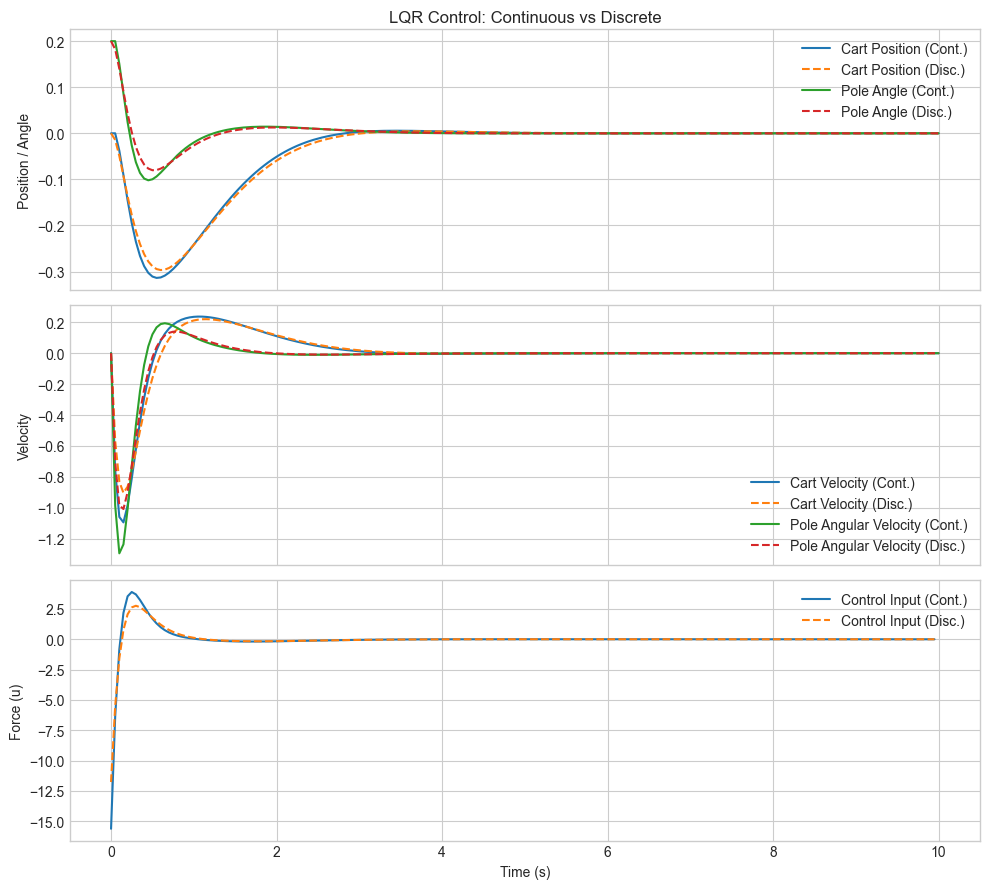

In [ ]:
# Shared LQR Parameters
Q = np.diag([1.0, 0.1, 10.0, 0.1])
R = np.array([[0.01]])
x0_lqr = np.array([0.0, 0.0, 0.2, 0.0])
t_span_lqr = (0, 10)
dt_lqr = 0.05

# continuous time lqr
P_c = scipy.linalg.solve_continuous_are(A_lin, B_lin, Q, R)
K_c = np.linalg.inv(R) @ B_lin.T @ P_c

#discrete time lqr
sys_d = cont2discrete((A_lin, B_lin, np.eye(4), np.zeros((4,1))), dt_lqr)
A_d, B_d = sys_d[0], sys_d[1]
P_d = scipy.linalg.solve_discrete_are(A_d, B_d, Q, R)
K_d = np.linalg.inv(B_d.T @ P_d @ B_d + R) @ (B_d.T @ P_d @ A_d)



def simulate_continuous(A, B, K, x0, t_span, dt):
    n_steps = int(t_span[1] / dt)
    t = np.linspace(t_span[0], t_span[1], n_steps + 1)
    x_traj = np.zeros((A.shape[0], n_steps + 1))
    u_traj = np.zeros((1, n_steps))
    x = x0.copy()
    x_traj[:, 0] = x

    for i in range(n_steps):
        u = -K @ x
        #x_dot = Ax + Bu
        x_dot = A @ x + B @ u
        # integrate using euler
        x = x + x_dot * dt
        x_traj[:, i + 1] = x
        u_traj[:, i] = u
    return t, x_traj, u_traj

def simulate_discrete(A, B, K, x0, t_span, dt):
    n_steps = int(t_span[1] / dt)
    t = np.linspace(t_span[0], t_span[1], n_steps + 1)
    x_traj = np.zeros((A.shape[0], n_steps + 1))
    u_traj = np.zeros((1, n_steps))
    x = x0.copy()
    x_traj[:, 0] = x

    for i in range(n_steps):
        u = -K @ x
        #x+ = Ax + Bu (discrete)
        x = A @ x + B @ u
        
        x_traj[:, i + 1] = x
        u_traj[:, i] = u
    return t, x_traj, u_traj


t_c, x_c, u_c = simulate_continuous(A_lin, B_lin, K_c, x0_lqr, t_span_lqr, dt_lqr)
t_d, x_d, u_d = simulate_discrete(A_d, B_d, K_d, x0_lqr, t_span_lqr, dt_lqr)


def plot_lqr_results(t1, x1, u1, t2, x2, u2):
    fig, axs = plt.subplots(3, 1, figsize=(10, 9), sharex=True)

    axs[0].plot(t1, x1[0], label='Cart Position (Cont.)')
    axs[0].plot(t2, x2[0], '--', label='Cart Position (Disc.)')
    axs[0].plot(t1, x1[2], label='Pole Angle (Cont.)')
    axs[0].plot(t2, x2[2], '--', label='Pole Angle (Disc.)')
    axs[0].set_ylabel("Position / Angle")
    axs[0].legend()
    axs[0].set_title("LQR Control: Continuous vs Discrete")

    axs[1].plot(t1, x1[1], label='Cart Velocity (Cont.)')
    axs[1].plot(t2, x2[1], '--', label='Cart Velocity (Disc.)')
    axs[1].plot(t1, x1[3], label='Pole Angular Velocity (Cont.)')
    axs[1].plot(t2, x2[3], '--', label='Pole Angular Velocity (Disc.)')
    axs[1].set_ylabel("Velocity")
    axs[1].legend()

    axs[2].plot(t1[:-1], u1[0], label='Control Input (Cont.)')
    axs[2].plot(t2[:-1], u2[0], '--', label='Control Input (Disc.)')
    axs[2].set_xlabel("Time (s)")
    axs[2].set_ylabel("Force (u)")
    axs[2].legend()

    plt.tight_layout()
    plt.show()

plot_lqr_results(t_c, x_c, u_c, t_d, x_d, u_d)


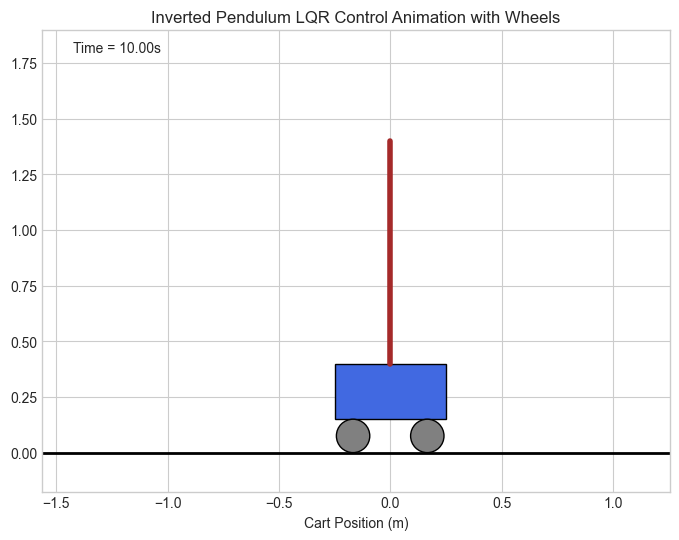

In [74]:
# Animation of the LQR Controlled Inverted Pendulum (with Wheels)
# A lot help from gpt

import matplotlib.animation as animation
from IPython.display import HTML # For displaying in Jupyter/Colab

# Ensure a new figure is created for animation
plt.close('all')

# Choose trajectory: either x_c (continuous) or x_d (discrete)
# Just switch this one line to change the animation source
CONTINUOUS = True

if CONTINUOUS:
    x_traj_lqr = x_c
    t_lqr = t_c
else:
    x_traj_lqr = x_d
    t_lqr = t_d

dt_lqr = t_lqr[1] - t_lqr[0]


fig_anim, ax_anim = plt.subplots(figsize=(10, 6))

# Physical pole length (from your model, adjust if needed)
L_pole_actual = l  # Should already be defined
# Cart and Wheel Parameters
cart_width = 0.5
cart_height = 0.25
wheel_radius = 0.075 # Radius of the wheels
wheel_color = 'gray'
cart_body_bottom_y = 2 * wheel_radius # Cart body sits on top of wheels (center at y=radius)
pole_pivot_y_offset = cart_height # Pole pivots on top of cart body

# Pole pivot y-coordinate (base of pole on top of cart)
pole_pivot_absolute_y = cart_body_bottom_y + pole_pivot_y_offset

# Set up the plot limits
x_min_traj = np.min(x_traj_lqr[0, :])
x_max_traj = np.max(x_traj_lqr[0, :])
x_range_traj = x_max_traj - x_min_traj
padding_x = max(L_pole_actual + cart_width / 2, x_range_traj * 0.2, 1.0)

ax_anim.set_xlim(x_min_traj - padding_x, x_max_traj + padding_x)
# Adjust y-limits to ensure wheels and full pole swing are visible
ax_anim.set_ylim(-wheel_radius - 0.1, pole_pivot_absolute_y + L_pole_actual + 0.5)
ax_anim.set_aspect('equal', adjustable='box')
ax_anim.grid(True)
ax_anim.set_xlabel("Cart Position (m)")
ax_anim.set_title("Inverted Pendulum LQR Control Animation with Wheels")

# Ground line
ground_min_x, ground_max_x = ax_anim.get_xlim()
ax_anim.plot([ground_min_x, ground_max_x], [0, 0], 'k-', lw=2) # Ground at y=0

# Initial positions based on x0_lqr
initial_cart_x = x0_lqr[0]
initial_theta = x0_lqr[2]

# Initialize plotting objects
# Cart Body: a rectangle patch
cart_body = plt.Rectangle((initial_cart_x - cart_width / 2, cart_body_bottom_y),
                          cart_width, cart_height, fc='royalblue', ec='black')
ax_anim.add_patch(cart_body)

# Wheels: Circle patches
# Wheel x positions relative to cart_x (center of the cart body)
wheel_offset_x1 = -cart_width / 3
wheel_offset_x2 = cart_width / 3

wheel1 = plt.Circle((initial_cart_x + wheel_offset_x1, wheel_radius),
                    wheel_radius, fc=wheel_color, ec='black')
wheel2 = plt.Circle((initial_cart_x + wheel_offset_x2, wheel_radius),
                    wheel_radius, fc=wheel_color, ec='black')
ax_anim.add_patch(wheel1)
ax_anim.add_patch(wheel2)

# Pole: a line
pole_pivot_x_init = initial_cart_x
pole_x_end_init = pole_pivot_x_init + L_pole_actual * np.sin(initial_theta)
pole_y_end_init = pole_pivot_absolute_y + L_pole_actual * np.cos(initial_theta)
pole_line, = ax_anim.plot([pole_pivot_x_init, pole_x_end_init],
                          [pole_pivot_absolute_y, pole_y_end_init], 'brown', lw=4)

# Time text
time_template = 'Time = %.2fs'
time_text = ax_anim.text(0.05, 0.95, '', transform=ax_anim.transAxes) # Adjusted y for visibility

# Initialization function for the animation
def init_anim():
    cart_body.set_xy((initial_cart_x - cart_width / 2, cart_body_bottom_y))
    wheel1.center = (initial_cart_x + wheel_offset_x1, wheel_radius)
    wheel2.center = (initial_cart_x + wheel_offset_x2, wheel_radius)

    pole_pivot_x = initial_cart_x
    pole_x_end = pole_pivot_x + L_pole_actual * np.sin(initial_theta)
    pole_y_end = pole_pivot_absolute_y + L_pole_actual * np.cos(initial_theta)
    pole_line.set_data([pole_pivot_x, pole_x_end], [pole_pivot_absolute_y, pole_y_end])
    time_text.set_text(time_template % 0.0)
    return cart_body, wheel1, wheel2, pole_line, time_text

# Animation update function
def animate_pendulum(i):
    cart_x = x_traj_lqr[0, i]
    theta = x_traj_lqr[2, i]

    # Update cart body position
    cart_body.set_xy((cart_x - cart_width / 2, cart_body_bottom_y))

    # Update wheel positions
    wheel1.center = (cart_x + wheel_offset_x1, wheel_radius)
    wheel2.center = (cart_x + wheel_offset_x2, wheel_radius)

    # Update pole position
    pole_pivot_x = cart_x
    pole_x_end = pole_pivot_x + L_pole_actual * np.sin(theta)
    pole_y_end = pole_pivot_absolute_y + L_pole_actual * np.cos(theta)
    pole_line.set_data([pole_pivot_x, pole_x_end], [pole_pivot_absolute_y, pole_y_end])

    time_text.set_text(time_template % (t_lqr[i]))
    return cart_body, wheel1, wheel2, pole_line, time_text

# Create the animation
interval = dt_lqr * 1000
num_frames_anim = x_traj_lqr.shape[1]

ani = animation.FuncAnimation(fig_anim, animate_pendulum, frames=num_frames_anim,
                              init_func=init_anim, blit=True, interval=interval, repeat=False)

# Display the animation
plt.rcParams["animation.html"] = "jshtml"
html_output = HTML(ani.to_jshtml())

In [75]:
# Play 
html_output

## So, LQR Worked for Flat Ground... What About a wavy ground?? (still experimental)?

Alright, our LQR controller did a decent job keeping the pendulum up when the ground was flat. That's because LQR is a champ when the system behaves in a nice, predictable (linear) way around its balance point.

But nwhat if the ground is wavy??

This changes everything:
* The "down" direction for gravity effectively tilts with the slope.
* The forces on the cart are way more complicated.
* Our simple LQR model, which thinks the world is flat and linear, is going to struggle. 

**Reinforcement Learning (RL), specifically A2C:**

Instead of trying to perfectly model this new, bumpy world (which would be tough), we can use RL. RL agents learn through trial and error, figuring out what works by getting rewards or penalties from the environment.

We're going to try an **Advantage Actor-Critic (A2C)** agent. Think of it like having two brains working together:

1.  **The Actor:** This is the "doer." It decides what force to apply to the cart (`action`) based on the current situation (`state`). Its job is to learn the best moves.
2.  **The Critic:** This is the "judge." It doesn't pick actions, but it evaluates how good the Actor's chosen situations (states) are. It learns a *value function* – basically, "how much future reward can we expect from this state?"

**How Do They Learn? The Bellman Connection (Simplified):**

Both the Actor and Critic learn from experience. The Critic, in particular, uses an idea rooted in **Bellman's equations**. In very simple terms, Bellman's insight helps the Critic figure out the value of a state by saying something like:

*"The value of being in the current state is the immediate reward I get, plus the discounted value of whatever state I land in next."*

So, the Critic learns to predict these values ($V(s)$). The Actor then uses the Critic's evaluations (specifically, something called the "advantage" – how much better an action was than expected) to update its own strategy. If an action led to a better-than-expected outcome according to the Critic, the Actor is more likely to take that kind of action in the future.

This way, even without a perfect model of the wavy terrain, our A2C agent can hopefully learn a robust strategy to keep that pendulum balanced!

In [ ]:
#Incase not there - Install Dependencies (PyTorch and Gymnasium)
# Run this cell if you don't have PyTorch or Gymnasium installed,
# or if you want to ensure you have reasonably up-to-date versions.

try:
    import torch
    print(f"PyTorch already installed. Version: {torch.__version__}")
except ImportError:
    print("PyTorch not found. Installing PyTorch...")
    %pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118
    print("PyTorch installation attempt complete.")
    import torch
    print(f"PyTorch installed. Version: {torch.__version__}")

try:
    import gymnasium
    print(f"Gymnasium already installed. Version: {gymnasium.__version__}")
except ImportError:
    print("Gymnasium not found. Installing Gymnasium...")
    %pip install gymnasium[classic_control,box2d]
    print("Gymnasium installation attempt complete.")
    import gymnasium
    print(f"Gymnasium installed. Version: {gymnasium.__version__}")

print("\nDependency check complete.")

PyTorch already installed. Version: 2.4.1
Gymnasium already installed. Version: 1.0.0

Dependency check complete.


In [ ]:
# Inverted Pendulum Environment for RL (with Wavy Surface)
import numpy as np
import gymnasium as gym
from gymnasium import spaces
# For RL (PyTorch for neural networks)
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F



# Need to inherit dynamics class
class InvertedPendulumEnv(gym.Env, LinearizedInvertedPendulum):
    metadata = {'render_modes': ['human', 'rgb_array'], 'render_fps': 50} # render_fps can be adjusted

    def __init__(self, wavy_surface=False, render_mode=None):

        # Using the global variabs defined previously
        super(InvertedPendulumEnv, self).__init__(mass_of_cart=m_c, mass_of_pole=m_p, length_of_pole=l, gravity=g)
        self.wavy_surface = wavy_surface
        self.render_mode = render_mode

        self.dt = 0.02  # Simulation time step

        # Action space: continuous force on the cart
        self.action_space = spaces.Box(low=-10.0, high=10.0, shape=(1,), dtype=np.float32)

        # Observation space: [x, x_dot, theta, theta_dot]
        # theta is angle from the normal to the cart's surface (slope)
        obs_limit = np.array([
            2.4,        # x limit (cart position)
            np.finfo(np.float32).max, # x_dot
            np.pi / 2,  # theta limit (pole angle from surface normal)
            np.finfo(np.float32).max  # theta_dot
        ], dtype=np.float32)
        self.observation_space = spaces.Box(low=-obs_limit, high=obs_limit, dtype=np.float32)

        self.state = None
        self.steps_beyond_terminated = None

        # Wavy surface parameters
        if self.wavy_surface:
            self.wave_amplitude = 0.5  # m (Increased amplitude for better visibility)
            self.wave_frequency = 1.5  # rad/m (Adjust spatial frequency as needed)
        else:
            self.wave_amplitude = 0.0
            self.wave_frequency = 0.0

    def _get_surface_slope(self, x_cart):
        if not self.wavy_surface:
            return 0.0
        # slope = d/dx (amplitude * sin(frequency * x)) = amplitude * frequency * cos(frequency * x)
        return self.wave_amplitude * self.wave_frequency * np.cos(self.wave_frequency * x_cart)

    def _get_surface_height(self, x_cart): # ADDED THIS METHOD
        if not self.wavy_surface:
            return 0.0
        return self.wave_amplitude * np.sin(self.wave_frequency * x_cart)

    def step(self, action):
        if not self.action_space.contains(action): # Check if action is an array/list
            action_val = action[0] if isinstance(action, (list, np.ndarray)) and len(action)>0 else float(action)
        else: # If it's already a correct Box element
            action_val = action[0]

        force = np.clip(action_val, self.action_space.low[0], self.action_space.high[0])

        x, x_dot, theta, theta_dot = self.state

        # Surface properties
        ground_slope = self._get_surface_slope(x) # This is dy/dx
        phi_ground = np.arctan(ground_slope)    # Angle of the slope

        # Effective gravity component normal to the slope (for pole dynamics)
        g_eff_pole = self.g * np.cos(phi_ground)
        # Force on cart due to gravity along the slope
        force_on_cart_due_to_slope = -self.mc * self.g * np.sin(phi_ground)
        # It's also common to include the pole's mass component: -(self.mc + self.mp) * self.g * np.sin(phi_ground)
        # For simplicity, we use m_c here, assuming 'force' acts along the slope on the cart.

        effective_force_on_cart = force + force_on_cart_due_to_slope

        # Dynamics (using OpenAI Gym classic_control cartpole.py structure, adapted)
        # Here 'theta' is angle of pole from the normal to the current surface.
        s_theta = np.sin(theta)
        c_theta = np.cos(theta)
        pole_mass_length = self.mp * self.l_com
        total_mass = self.mc + self.mp

        temp_term = (effective_force_on_cart + pole_mass_length * theta_dot**2 * s_theta) / total_mass

        # Numerator for angular acceleration of the pole
        # (Torque due to effective gravity normal to slope) - (Torque due to horizontal acceleration effect)
        theta_acc_numerator = (g_eff_pole * s_theta) - (c_theta * temp_term)


        # Need to verigfy..
        # Denominator for angular acceleration
        # This term (4.0/3.0) implies assumptions about pole's moment of inertia,
        # specifically I_pivot = (4/3) * m_p * L^2 if L is half-length of a rod of length 2L.
        # Or, if L is pivot to COM, it means I_com = (1/3) * m_p * L^2.
        # Given our I_pole_com from Cell 2 is (1/12)m(2L)^2 = (1/3)m L^2, this is consistent.
        pole_length_factor = self.l_com * (4.0 / 3.0 - (self.mp * c_theta**2) / total_mass)
        theta_acc = theta_acc_numerator / pole_length_factor
        # Linear acceleration of the cart
        x_acc = temp_term - (pole_mass_length * theta_acc * c_theta) / total_mass

        # Euler integration
        x_dot_new = x_dot + x_acc * self.dt
        theta_dot_new = theta_dot + theta_acc * self.dt
        
        x_new = x + x_dot_new * self.dt
        theta_new = theta + theta_dot_new * self.dt
        
        self.state = np.array([x_new, x_dot_new, theta_new, theta_dot_new], dtype=np.float32)

        # Termination conditions
        terminated = bool(
            x_new < -self.observation_space.high[0]  # Cart position limit
            or x_new > self.observation_space.high[0]
            or np.abs(theta_new) > self.observation_space.high[2]  # Pole angle from normal limit
        )

        # Reward function
        if not terminated:
            reward = (
                -0.1 * (x_new ** 2)
                -0.1 * (x_dot_new ** 2)
                -5.0 * (theta_new ** 2)
                -0.1 * (theta_dot_new ** 2)
                -0.001 * (force ** 2)
                + 10.0
            )
        elif self.steps_beyond_terminated is None:
            # Pole fell or cart went off track
            self.steps_beyond_terminated = 0
            reward = -100.0 # Large penalty for terminations
        else:
            # Already terminated
            self.steps_beyond_terminated += 1
            reward = 0.0

        info = {}
        
        return self.state, reward, terminated, False, info

    def reset(self, seed=None, options=None):
        super().reset(seed=seed)
        # Initialize state with slight random perturbation from upright
        self.state = self.np_random.uniform(low=-0.05, high=0.05, size=(4,))
        # Cart can start a bit off-center, e.g., if surface is wavy, 0 might not be lowest point.
        self.state[0] = self.np_random.uniform(low=-0.1, high=0.1)
        self.state[2] = self.np_random.uniform(low=-0.05, high=0.05) # Pole angle relative to normal
        self.steps_beyond_terminated = None
        return self.state, {}



print("Defining env_flat and env_wavy...")
try:
    env_flat = InvertedPendulumEnv(wavy_surface=False)
    env_wavy = InvertedPendulumEnv(wavy_surface=True)
    print("env_flat and env_wavy created successfully.")
except NameError as e:
    print(f"Error creating environments: {e}. Make sure global parameters (g, m_c, m_p, L, I_pole_com) are defined from Cell 2.")

Defining env_flat and env_wavy...
env_flat and env_wavy created successfully.



Training RL agent on WAVY surface...
Episode 50 | Avg Reward: 37.25 | Critic Loss: 1237.5892
Episode 100 | Avg Reward: 100.24 | Critic Loss: 2530.9185
Episode 150 | Avg Reward: 179.82 | Critic Loss: 967.2781
Episode 200 | Avg Reward: 267.97 | Critic Loss: 2099.8113
Episode 250 | Avg Reward: 649.34 | Critic Loss: 68275.7344
Episode 300 | Avg Reward: 685.91 | Critic Loss: 2018.9305
Episode 350 | Avg Reward: 793.59 | Critic Loss: 36693.2266
Episode 400 | Avg Reward: 936.35 | Critic Loss: 14763.7451
Episode 450 | Avg Reward: 640.26 | Critic Loss: 3007.8562
Episode 500 | Avg Reward: 798.26 | Critic Loss: 628.2123
Episode 550 | Avg Reward: 1071.83 | Critic Loss: 35765.0625
Episode 600 | Avg Reward: 1336.30 | Critic Loss: 1205.4010
Episode 650 | Avg Reward: 1441.62 | Critic Loss: 22957.0918
Episode 700 | Avg Reward: 1337.48 | Critic Loss: 12049.5811
Episode 750 | Avg Reward: 1463.51 | Critic Loss: 15445.0791
Episode 800 | Avg Reward: 1392.34 | Critic Loss: 10272.0410
Episode 850 | Avg Reward

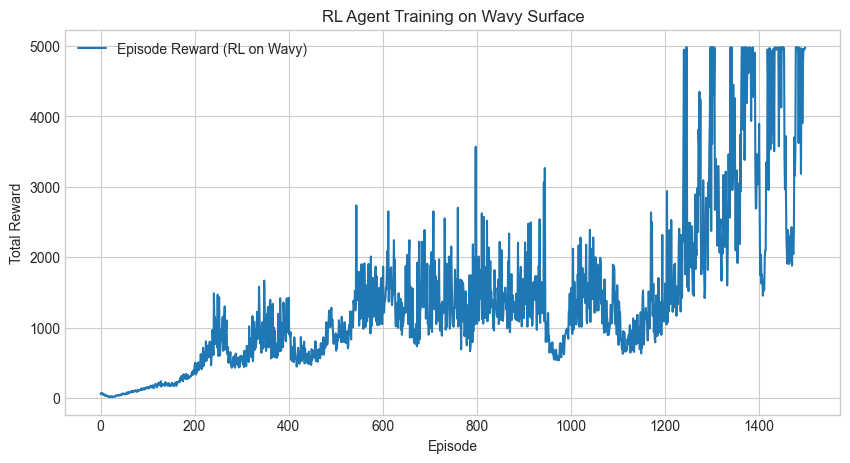

In [85]:
# Cell 7: Actor-Critic (A2C-like) Agent
class Actor(nn.Module):
    def __init__(self, state_dim, action_dim, max_action):
        super(Actor, self).__init__()
        self.shared = nn.Sequential(
            nn.Linear(state_dim, 256),
            nn.ReLU(),
            nn.Linear(256, 256),
            nn.ReLU()
        )
        self.mean_layer = nn.Linear(256, action_dim)
        self.log_std = nn.Parameter(torch.zeros(action_dim))  # Learnable log std
        self.max_action = max_action

    def forward(self, x):
        features = self.shared(x)
        mean = self.max_action * torch.tanh(self.mean_layer(features))
        std = torch.exp(self.log_std)
        dist = torch.distributions.Normal(mean, std)
        return dist

class Critic(nn.Module):
    def __init__(self, state_dim):
        super(Critic, self).__init__()
        self.layer_1 = nn.Linear(state_dim, 256)
        self.layer_2 = nn.Linear(256, 256)
        self.layer_3 = nn.Linear(256, 1) # Outputs a single value (state value)

    def forward(self, x):
        x = F.relu(self.layer_1(x))
        x = F.relu(self.layer_2(x))
        x = self.layer_3(x)
        return x

# Training function for A2C-like agent
def train_a2c(env, actor, critic, actor_optimizer, critic_optimizer, K_lqr_init=None, episodes=1000, max_steps=500, gamma=0.99):
    episode_rewards = []

    for episode in range(episodes):
        state, _ = env.reset()
        current_episode_reward = 0

        states = []
        actions = []
        values = []
        rewards = []
        masks = []
        log_probs = []

        for step in range(max_steps):
            state_tensor = torch.FloatTensor(state).unsqueeze(0)
            dist = actor(state_tensor)
            action = dist.sample()
            log_prob = dist.log_prob(action).sum(dim=-1, keepdim=True)

            action_np = action.detach().cpu().numpy().flatten()
            next_state, reward, terminated, _, _ = env.step(action_np)

            value = critic(state_tensor)

            # Store for training
            states.append(state_tensor)
            actions.append(action)
            values.append(value)
            rewards.append(torch.tensor([[reward]], dtype=torch.float32))
            masks.append(torch.tensor([[1.0 - terminated]], dtype=torch.float32))
            log_probs.append(log_prob)

            state = next_state
            current_episode_reward += reward

            if terminated:
                break

        episode_rewards.append(current_episode_reward)

        # Get next value
        next_state_tensor = torch.FloatTensor(next_state).unsqueeze(0)
        with torch.no_grad():
            next_value = critic(next_state_tensor) if not terminated else torch.zeros_like(value)

        # Compute returns and advantages
        returns = []
        advantages = []
        R = next_value

        for i in reversed(range(len(rewards))):
            R = rewards[i] + gamma * R * masks[i]
            adv = R - values[i].detach()
            returns.insert(0, R)
            advantages.insert(0, adv)

        # Convert to tensors
        returns_tensor = torch.cat(returns)
        values_tensor = torch.cat(values)
        advantages_tensor = torch.cat(advantages)
        log_probs_tensor = torch.cat(log_probs)

        # Critic Loss: MSE between value estimates and returns
        critic_loss = F.mse_loss(values_tensor, returns_tensor.detach())
        critic_optimizer.zero_grad()
        critic_loss.backward()
        torch.nn.utils.clip_grad_norm_(critic.parameters(), max_norm=1.0)
        critic_optimizer.step()

        # Actor Loss: using advantage
        actor_loss = -(log_probs_tensor * advantages_tensor.detach()).mean()
        actor_optimizer.zero_grad()
        actor_loss.backward()
        torch.nn.utils.clip_grad_norm_(actor.parameters(), max_norm=1.0)
        actor_optimizer.step()

        if (episode + 1) % 50 == 0:
            avg_reward = np.mean(episode_rewards[-50:])
            print(f"Episode {episode+1} | Avg Reward: {avg_reward:.2f} | Critic Loss: {critic_loss.item():.4f}")

    return episode_rewards




# Hyperparameters for RL
state_dim = env_wavy.observation_space.shape[0]
action_dim = env_wavy.action_space.shape[0] # Should be 1
max_action = float(env_wavy.action_space.high[0])

actor_rl = Actor(state_dim, action_dim, max_action)
critic_rl = Critic(state_dim) # Critic estimates V(s)
actor_optimizer = optim.Adam(actor_rl.parameters(), lr=3e-4)
critic_optimizer = optim.Adam(critic_rl.parameters(), lr=1e-3)

# Train the RL agent on the wavy surface
print("\nTraining RL agent on WAVY surface...")


# Pass K_c if you want to try initializing (though current init is placeholder)
rl_rewards_wavy = train_a2c(env_wavy, actor_rl, critic_rl, actor_optimizer, critic_optimizer, 
                            K_lqr_init=K_c, episodes=1500, max_steps=500) # Reduced episodes for demo

# Plot RL training progress
plt.figure(figsize=(10, 5))
plt.plot(rl_rewards_wavy, label='Episode Reward (RL on Wavy)')
plt.xlabel('Episode')
plt.ylabel('Total Reward')
plt.title('RL Agent Training on Wavy Surface')
plt.legend()
plt.show()

In [86]:

if 'K_lqr' not in globals():
    print("Warning: K_lqr not found. Using a zero matrix for LQR evaluation.")
    # Adjust shape based on your environment's observation space if needed
    obs_dim = env_flat.observation_space.shape[0] if 'env_flat' in globals() else 4
    K_lqr = np.zeros((1, obs_dim))


def evaluate_policy(env, policy_fn, episodes=10, is_rl_policy=False, K_matrix=None, collect_trajectory_for_anim=False):
    total_rewards = []
    
    # For storing one trajectory for animation
    animation_states = []
    animation_surface_y = []
    animation_surface_phi = []
    animation_actions = [] # Optional, if needed later
    

    for ep in range(episodes):
        state, _ = env.reset()
        episode_reward = 0
        done = False
        steps = 0
        max_eval_steps = 500

        # Temp lists for current episode's trajectory (if collecting)
        current_ep_states = []
        current_ep_surface_y = []
        current_ep_surface_phi = []
        current_ep_actions = []

        while not done and steps < max_eval_steps:
            if collect_trajectory_for_anim and ep == 0: # Collect for the first episode only
                current_ep_states.append(state.copy())
                current_ep_surface_y.append(env._get_surface_height(state[0]))
                current_ep_surface_phi.append(np.arctan(env._get_surface_slope(state[0])))

            action = None # Initialize action
            if is_rl_policy:
                state_tensor = torch.FloatTensor(state).unsqueeze(0)
                # For evaluation, typically use the mean of the policy's action distribution
                mean_action = policy_fn(state_tensor) # Assuming actor returns mean, std
                action_tensor = mean_action.mean 
                action = action_tensor.detach().cpu().numpy().flatten()
                action = np.clip(action, env.action_space.low, env.action_space.high)
            elif K_matrix is not None: # LQR policy
                action = -K_matrix @ state
                action = np.clip(action, env.action_space.low, env.action_space.high).flatten()
            else: # Random policy
                action = env.action_space.sample().flatten()
            
            if collect_trajectory_for_anim and ep == 0:
                current_ep_actions.append(action.copy())
                
            state, reward, done, _, _ = env.step(action)
            episode_reward += reward
            steps += 1
        
        total_rewards.append(episode_reward)

        if collect_trajectory_for_anim and ep == 0:
            animation_states = current_ep_states
            animation_surface_y = current_ep_surface_y
            animation_surface_phi = current_ep_surface_phi
            animation_actions = current_ep_actions # Storing actions too, just in case

    mean_reward = np.mean(total_rewards)
    std_reward = np.std(total_rewards)

    if collect_trajectory_for_anim:
        return mean_reward, std_reward, animation_states, animation_actions, animation_surface_y, animation_surface_phi
    else:
        return mean_reward, std_reward

# --- Evaluations ---

# For LQR on WAVY surface (collect trajectory for animation)
print("\n--- Evaluating LQR controller on WAVY surface (for animation) ---")
# Ensure K_lqr is correctly shaped, e.g., (1, obs_dim) or handle scalar if action_dim is 1
k_lqr_eval = K_lqr
if k_lqr_eval.ndim == 1: # If K_lqr is [k1,k2,k3,k4]
    k_lqr_eval = K_lqr.reshape(1, -1) # Ensure it's a row vector for K @ state if state is column

# Check if env_wavy exists, otherwise fallback
if 'env_wavy' not in globals():
    print("Error: env_wavy not defined. Please run Cell 6 first.")
    # Create a dummy env or skip if critical, for now, assume it exists from Cell 6
else:
    avg_reward_lqr_wavy, std_reward_lqr_wavy, states_lqr_wavy, _, surf_y_lqr_wavy, surf_phi_lqr_wavy = \
        evaluate_policy(env_wavy, policy_fn=None, K_matrix=k_lqr_eval, episodes=1, collect_trajectory_for_anim=True)
    print(f"LQR on Wavy Surface (1 ep for anim): Reward = {avg_reward_lqr_wavy:.2f}")

# For RL agent on WAVY surface (collect trajectory for animation)
print("\n--- Evaluating Trained RL agent on WAVY surface (for animation) ---")
if 'actor_rl' not in globals() or 'env_wavy' not in globals():
    print("Error: actor_rl or env_wavy not defined. Please run previous cells.")
else:
    actor_rl.eval() # Ensure actor is in evaluation mode
    avg_reward_rl_on_wavy, std_reward_rl_on_wavy, states_rl_wavy, _, surf_y_rl_wavy, surf_phi_rl_wavy = \
        evaluate_policy(env_wavy, policy_fn=actor_rl, is_rl_policy=True, episodes=1, collect_trajectory_for_anim=True)
    print(f"RL Agent on Wavy Surface (1 ep for anim): Reward = {avg_reward_rl_on_wavy:.2f}")


# --- Standard Evaluations (without collecting full trajectories unless needed) ---
print("\n--- Standard Evaluation: LQR controller on WAVY surface ---")
if 'env_wavy' in globals():
    avg_reward_lqr_wavy_std, std_reward_lqr_wavy_std = evaluate_policy(env_wavy, policy_fn=None, K_matrix=k_lqr_eval, episodes=20)
    print(f"LQR on Wavy Surface (20 eps): Avg Reward = {avg_reward_lqr_wavy_std:.2f} +/- {std_reward_lqr_wavy_std:.2f}")

print("\n--- Standard Evaluation: Trained RL agent on WAVY surface ---")
if 'actor_rl' in globals() and 'env_wavy' in globals():
    actor_rl.eval()
    avg_reward_rl_on_wavy_std, std_reward_rl_on_wavy_std = evaluate_policy(env_wavy, policy_fn=actor_rl, is_rl_policy=True, episodes=20)
    print(f"RL Agent on Wavy Surface (20 eps): Avg Reward = {avg_reward_rl_on_wavy_std:.2f} +/- {std_reward_rl_on_wavy_std:.2f}")

print("\n--- Standard Evaluation: LQR controller on FLAT surface (for reference) ---")
if 'env_flat' in globals():
    avg_reward_lqr_on_flat, std_reward_lqr_on_flat = evaluate_policy(env_flat, policy_fn=None, K_matrix=k_lqr_eval, episodes=20)
    print(f"LQR on Flat Surface (20 eps): Avg Reward = {avg_reward_lqr_on_flat:.2f} +/- {std_reward_lqr_on_flat:.2f}")


--- Evaluating LQR controller on WAVY surface (for animation) ---
LQR on Wavy Surface (1 ep for anim): Reward = 70.35

--- Evaluating Trained RL agent on WAVY surface (for animation) ---
RL Agent on Wavy Surface (1 ep for anim): Reward = 4964.67

--- Standard Evaluation: LQR controller on WAVY surface ---
LQR on Wavy Surface (20 eps): Avg Reward = 64.87 +/- 6.79

--- Standard Evaluation: Trained RL agent on WAVY surface ---
RL Agent on Wavy Surface (20 eps): Avg Reward = 4966.66 +/- 14.70

--- Standard Evaluation: LQR controller on FLAT surface (for reference) ---
LQR on Flat Surface (20 eps): Avg Reward = 422.97 +/- 133.03



Displaying animation for RL Agent on WAVY surface (with tilting cart)...


Animation size has reached 21000400 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.



Displaying animation for LQR Controller on WAVY surface (with tilting cart)...


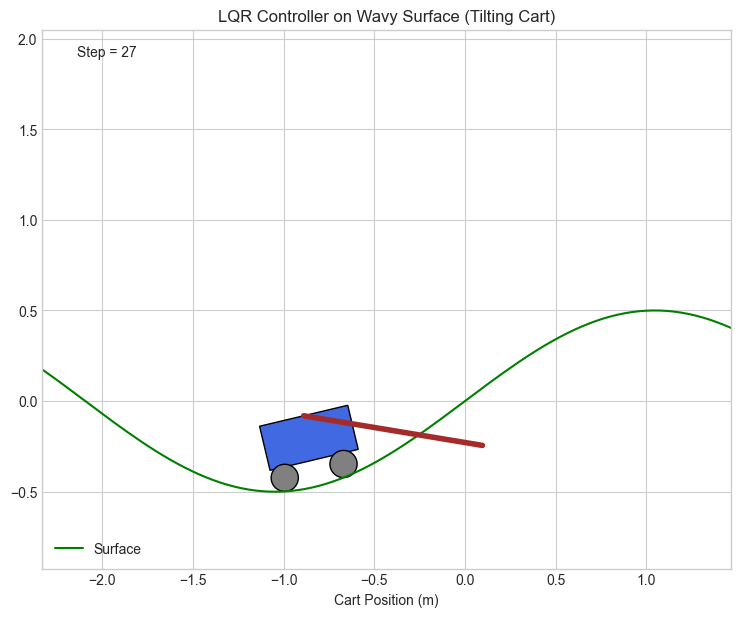

In [87]:
# Heavy use of GPT for animation

import matplotlib.animation as animation
from IPython.display import HTML, display # Ensure display is imported
import matplotlib.pyplot as plt
import numpy as np

# Ensure L_pole_actual, cart_width, cart_height, wheel_radius are defined
# These would typically come from Cell 2 and Cell 5 (LQR animation)
if 'L_pole_actual' not in globals(): L_pole_actual = 2 * 0.5 # Example from Cell 2 (L=0.5)
if 'cart_width' not in globals(): cart_width = 0.5
if 'cart_height' not in globals(): cart_height = 0.25
if 'wheel_radius' not in globals(): wheel_radius = 0.075 # Example value
wheel_color = 'gray'
# Wheel x-offsets from the cart's center (along its base)
wheel_offset_x1 = -cart_width / 3
wheel_offset_x2 = cart_width / 3


def animate_pendulum_trajectory(states_traj, surface_y_traj, surface_phi_traj, env_sim, title="Pendulum Animation"):
    plt.close('all')
    fig_anim, ax_anim = plt.subplots(figsize=(12, 7))

    num_frames = len(states_traj)
    if num_frames == 0:
        print("No trajectory data to animate.")
        return None

    all_x_cart = np.array([s[0] for s in states_traj])
    min_x_cart_traj = np.min(all_x_cart)
    max_x_cart_traj = np.max(all_x_cart)
    
    padding_x = max(L_pole_actual + cart_width / 2, (max_x_cart_traj - min_x_cart_traj) * 0.2, 1.5)
    anim_xlim = (min_x_cart_traj - padding_x, max_x_cart_traj + padding_x)

    # Determine y-limits based on surface and pole height, considering potential cart tilt
    # Max possible y deviation of cart corners due to tilt: cart_width/2 * sin(max_slope)
    max_abs_phi = np.max(np.abs(np.array(surface_phi_traj))) if surface_phi_traj else 0
    y_tilt_effect = (cart_width / 2) * np.sin(max_abs_phi) + (cart_height/2)*(1-np.cos(max_abs_phi)) # rough upper bound
    
    min_surface_y_anim = np.min(surface_y_traj) - wheel_radius - 0.2 - y_tilt_effect
    max_pole_tip_y_anim = np.max(np.array(surface_y_traj) + 2 * wheel_radius + cart_height + L_pole_actual) + 0.5 + y_tilt_effect
    anim_ylim = (min_surface_y_anim, max_pole_tip_y_anim)

    ax_anim.set_xlim(anim_xlim)
    ax_anim.set_ylim(anim_ylim)
    ax_anim.set_aspect('equal', adjustable='box')
    ax_anim.grid(True)
    ax_anim.set_xlabel("Cart Position (m)")
    ax_anim.set_title(title)

    ground_x_coords = np.linspace(anim_xlim[0] - 2, anim_xlim[1] + 2, 200)
    ground_y_coords = [env_sim._get_surface_height(gx) for gx in ground_x_coords]
    ground_line, = ax_anim.plot(ground_x_coords, ground_y_coords, 'g-', lw=1.5, label="Surface")

    # Initial state values
    initial_state = states_traj[0]
    initial_cart_x_center = initial_state[0] # This is the reference x-point for the cart on the slope
    initial_theta_from_normal = initial_state[2]
    initial_surface_y_at_cart_x = surface_y_traj[0]
    initial_surface_phi_rad = surface_phi_traj[0]

    # --- Calculate initial cart body properties for tilting cart ---
    # Midpoint of the cart's bottom edge will be at (initial_cart_x_center, initial_surface_y_at_cart_x + 2 * wheel_radius)
    initial_cart_bottom_mid_x = initial_cart_x_center
    initial_cart_bottom_mid_y = initial_surface_y_at_cart_x + 2 * wheel_radius
    
    # Calculate bottom-left (xy) of rectangle so it rotates around its center correctly (approximately)
    # The angle property rotates around xy. We want rotation around cart's effective center.
    # Simpler: define xy for horizontal cart, then angle rotates it.
    # For the Rectangle patch, 'angle' rotates around its 'xy' point (bottom-left).
    # To make it appear to rotate around the center of its base:
    rect_x_init = initial_cart_bottom_mid_x - (cart_width / 2) * np.cos(initial_surface_phi_rad)
    rect_y_init = initial_cart_bottom_mid_y - (cart_width / 2) * np.sin(initial_surface_phi_rad)
    
    cart_body = plt.Rectangle((rect_x_init, rect_y_init),
                              cart_width, cart_height, angle=np.degrees(initial_surface_phi_rad),
                              fc='royalblue', ec='black')
    ax_anim.add_patch(cart_body)

    # --- Wheels ---
    # Wheels' x-positions are relative to initial_cart_x_center, adjusted for slope projection
    wheel1_center_x_init = initial_cart_x_center + wheel_offset_x1 * np.cos(initial_surface_phi_rad)
    wheel2_center_x_init = initial_cart_x_center + wheel_offset_x2 * np.cos(initial_surface_phi_rad)
    # Wheels' y-positions are always wheel_radius above the surface_y at their respective x-coordinates.
    # For simplicity, we'll use surface_y_at_cart_x for their y, assuming wheel offsets are small.
    wheel1 = plt.Circle((wheel1_center_x_init, initial_surface_y_at_cart_x + wheel_radius),
                        wheel_radius, fc=wheel_color, ec='black')
    wheel2 = plt.Circle((wheel2_center_x_init, initial_surface_y_at_cart_x + wheel_radius),
                        wheel_radius, fc=wheel_color, ec='black')
    ax_anim.add_patch(wheel1)
    ax_anim.add_patch(wheel2)

    # --- Pole ---
    # Pole pivot is at the center of the cart's top surface.
    # Local coords of pivot on cart (origin at cart_body.xy): (cart_width/2, cart_height)
    pivot_local_x_on_cart = cart_width / 2
    pivot_local_y_on_cart = cart_height
    # Rotate this local point by cart's angle
    rotated_pivot_offset_x = pivot_local_x_on_cart * np.cos(initial_surface_phi_rad) - \
                             pivot_local_y_on_cart * np.sin(initial_surface_phi_rad)
    rotated_pivot_offset_y = pivot_local_x_on_cart * np.sin(initial_surface_phi_rad) + \
                             pivot_local_y_on_cart * np.cos(initial_surface_phi_rad)
    # Absolute world coordinates of the pivot
    pole_pivot_x_init = rect_x_init + rotated_pivot_offset_x
    pole_pivot_y_init = rect_y_init + rotated_pivot_offset_y
    
    pole_angle_world_init = initial_theta_from_normal + initial_surface_phi_rad
    pole_x_end_init = pole_pivot_x_init + L_pole_actual * np.sin(pole_angle_world_init)
    pole_y_end_init = pole_pivot_y_init + L_pole_actual * np.cos(pole_angle_world_init)
    pole_line, = ax_anim.plot([pole_pivot_x_init, pole_x_end_init],
                              [pole_pivot_y_init, pole_y_end_init], 'brown', lw=4)

    time_template = 'Step = %d'
    time_text = ax_anim.text(0.05, 0.95, '', transform=ax_anim.transAxes)
    ax_anim.legend(loc='lower left')

    def init_anim_traj():
        # Recalculate initial positions exactly as above for clarity
        phi_init_rad = initial_surface_phi_rad # from outer scope
        
        rect_x_val_init = initial_cart_bottom_mid_x - (cart_width / 2) * np.cos(phi_init_rad)
        rect_y_val_init = initial_cart_bottom_mid_y - (cart_width / 2) * np.sin(phi_init_rad)
        cart_body.set_xy((rect_x_val_init, rect_y_val_init))
        cart_body.set_angle(np.degrees(phi_init_rad))

        wheel1.center = (initial_cart_x_center + wheel_offset_x1 * np.cos(phi_init_rad), 
                         initial_surface_y_at_cart_x + wheel_radius)
        wheel2.center = (initial_cart_x_center + wheel_offset_x2 * np.cos(phi_init_rad), 
                         initial_surface_y_at_cart_x + wheel_radius)
        
        rotated_pivot_offset_x_val = pivot_local_x_on_cart * np.cos(phi_init_rad) - \
                                     pivot_local_y_on_cart * np.sin(phi_init_rad)
        rotated_pivot_offset_y_val = pivot_local_x_on_cart * np.sin(phi_init_rad) + \
                                     pivot_local_y_on_cart * np.cos(phi_init_rad)
        pole_pivot_x_val_init = rect_x_val_init + rotated_pivot_offset_x_val
        pole_pivot_y_val_init = rect_y_val_init + rotated_pivot_offset_y_val
        
        pole_angle_w_init = initial_theta_from_normal + phi_init_rad
        pole_line.set_data([pole_pivot_x_val_init, pole_pivot_x_val_init + L_pole_actual * np.sin(pole_angle_w_init)],
                           [pole_pivot_y_val_init, pole_pivot_y_val_init + L_pole_actual * np.cos(pole_angle_w_init)])
        time_text.set_text(time_template % 0)
        return cart_body, wheel1, wheel2, pole_line, time_text, ground_line

    def animate_frame(i):
        state_i = states_traj[i]
        cart_x_center_i = state_i[0]
        theta_from_normal_i = state_i[2]
        
        surface_y_at_cart_x_i = surface_y_traj[i]
        surface_phi_rad_i = surface_phi_traj[i]

        # --- Update Cart Body ---
        cart_bottom_mid_x_val_i = cart_x_center_i
        cart_bottom_mid_y_val_i = surface_y_at_cart_x_i + 2 * wheel_radius
        
        rect_x_val_i = cart_bottom_mid_x_val_i - (cart_width / 2) * np.cos(surface_phi_rad_i)
        rect_y_val_i = cart_bottom_mid_y_val_i - (cart_width / 2) * np.sin(surface_phi_rad_i)
        cart_body.set_xy((rect_x_val_i, rect_y_val_i))
        cart_body.set_angle(np.degrees(surface_phi_rad_i)) # Set angle in degrees

        # --- Update Wheels ---
        # For more accuracy, wheel y-positions should use surface height at their specific x-coords
        wheel1_x_i = cart_x_center_i + wheel_offset_x1 * np.cos(surface_phi_rad_i)
        wheel2_x_i = cart_x_center_i + wheel_offset_x2 * np.cos(surface_phi_rad_i)
        wheel1.center = (wheel1_x_i, env_sim._get_surface_height(wheel1_x_i) + wheel_radius)
        wheel2.center = (wheel2_x_i, env_sim._get_surface_height(wheel2_x_i) + wheel_radius)
        
        # --- Update Pole ---
        rotated_pivot_offset_x_val_i = pivot_local_x_on_cart * np.cos(surface_phi_rad_i) - \
                                       pivot_local_y_on_cart * np.sin(surface_phi_rad_i)
        rotated_pivot_offset_y_val_i = pivot_local_x_on_cart * np.sin(surface_phi_rad_i) + \
                                       pivot_local_y_on_cart * np.cos(surface_phi_rad_i)
        pole_pivot_x_abs_i = rect_x_val_i + rotated_pivot_offset_x_val_i
        pole_pivot_y_abs_i = rect_y_val_i + rotated_pivot_offset_y_val_i
        
        pole_angle_world_i = theta_from_normal_i + surface_phi_rad_i
        pole_x_end = pole_pivot_x_abs_i + L_pole_actual * np.sin(pole_angle_world_i)
        pole_y_end = pole_pivot_y_abs_i + L_pole_actual * np.cos(pole_angle_world_i)
        pole_line.set_data([pole_pivot_x_abs_i, pole_x_end], [pole_pivot_y_abs_i, pole_y_end])

        time_text.set_text(time_template % i)
        
        current_xlim = ax_anim.get_xlim()
        view_width = current_xlim[1] - current_xlim[0]
        if cart_x_center_i < current_xlim[0] + view_width * 0.3 or cart_x_center_i > current_xlim[1] - view_width * 0.3:
            ax_anim.set_xlim(cart_x_center_i - view_width/2, cart_x_center_i + view_width/2)
            new_ground_x = np.linspace(ax_anim.get_xlim()[0]-2, ax_anim.get_xlim()[1]+2, 200)
            new_ground_y = [env_sim._get_surface_height(gx) for gx in new_ground_x]
            ground_line.set_data(new_ground_x, new_ground_y)

        return cart_body, wheel1, wheel2, pole_line, time_text, ground_line

    interval_ms = env_sim.dt * 1000 * 1.0 # Speed factor, 1.0 for real-time based on dt
    
    ani = animation.FuncAnimation(fig_anim, animate_frame, frames=num_frames,
                                  init_func=init_anim_traj, blit=True, interval=interval_ms, repeat=False)
    
    plt.rcParams["animation.html"] = "jshtml"
    return HTML(ani.to_jshtml())


# --- Generate and display animations ---
# Ensure Cell 8 has been run to generate these trajectory variables:
# states_rl_wavy, surf_y_rl_wavy, surf_phi_rl_wavy
# states_lqr_wavy, surf_y_lqr_wavy, surf_phi_lqr_wavy
# And env_wavy is the environment instance from Cell 6.

if 'states_rl_wavy' in globals() and 'env_wavy' in globals():
    print("\nDisplaying animation for RL Agent on WAVY surface (with tilting cart)...")
    anim_rl_wavy = animate_pendulum_trajectory(states_rl_wavy, surf_y_rl_wavy, surf_phi_rl_wavy, env_wavy, 
                                               title="RL Agent on Wavy Surface (Tilting Cart)")
    if anim_rl_wavy:
        display(anim_rl_wavy)
    else:
        print("Failed to generate RL animation.")
else:
    print("Skipping RL animation: 'states_rl_wavy' or 'env_wavy' not found. Please run Cell 8 and Cell 6.")

if 'states_lqr_wavy' in globals() and 'env_wavy' in globals():
    print("\nDisplaying animation for LQR Controller on WAVY surface (with tilting cart)...")
    anim_lqr_wavy = animate_pendulum_trajectory(states_lqr_wavy, surf_y_lqr_wavy, surf_phi_lqr_wavy, env_wavy,
                                                title="LQR Controller on Wavy Surface (Tilting Cart)")
    if anim_lqr_wavy:
        display(anim_lqr_wavy)
    else:
        print("Failed to generate LQR animation.")
else:
    print("Skipping LQR animation: 'states_lqr_wavy' or 'env_wavy' not found. Please run Cell 8 and Cell 6.")